In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [18]:
anuncios = pd.read_csv("advertising.csv")

In [19]:
anuncios.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 10 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   tempo_diario_site     1000 non-null   float64
 1   idade                 1000 non-null   int64  
 2   renda_media_regiao    1000 non-null   float64
 3   tempo_medio_internet  1000 non-null   float64
 4   titulo                1000 non-null   object 
 5   cidade                1000 non-null   object 
 6   sexo                  1000 non-null   int64  
 7   pais                  1000 non-null   object 
 8   timestamp_clique      1000 non-null   object 
 9   clique                1000 non-null   int64  
dtypes: float64(3), int64(3), object(4)
memory usage: 78.3+ KB


In [20]:
anuncios.describe()

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,sexo,clique
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000
mean,65.000200,36.009000,55000.000080,180.000100,0.481000,0.50000
std,15.853615,8.785562,13414.634022,43.902339,0.499889,0.50025
min,32.600000,19.000000,13996.500000,104.780000,0.000000,0.00000
25%,51.360000,29.000000,47031.802500,138.830000,0.000000,0.00000
50%,68.215000,35.000000,57012.300000,183.130000,0.000000,0.50000
75%,78.547500,42.000000,65470.635000,218.792500,1.000000,1.00000
max,91.430000,61.000000,79484.800000,269.960000,1.000000,1.00000


timestamp_clique --> tranformar de Obj para time

In [21]:
anuncios["timestamp_clique"] = pd.to_datetime(anuncios["timestamp_clique"])

In [22]:
# anuncios["ano"] = anuncios["timestamp_clique"].dt.year
# Ano é irrelevante pois só tem 2016


anuncios["mes"] = anuncios["timestamp_clique"].dt.month
anuncios["dia"] = anuncios["timestamp_clique"].dt.day
anuncios["hora"] = anuncios["timestamp_clique"].dt.hour


In [23]:
anuncios = anuncios.drop(columns=["timestamp_clique"])

In [24]:
anuncios.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   tempo_diario_site     1000 non-null   float64
 1   idade                 1000 non-null   int64  
 2   renda_media_regiao    1000 non-null   float64
 3   tempo_medio_internet  1000 non-null   float64
 4   titulo                1000 non-null   object 
 5   cidade                1000 non-null   object 
 6   sexo                  1000 non-null   int64  
 7   pais                  1000 non-null   object 
 8   clique                1000 non-null   int64  
 9   mes                   1000 non-null   int32  
 10  dia                   1000 non-null   int32  
 11  hora                  1000 non-null   int32  
dtypes: float64(3), int32(3), int64(3), object(3)
memory usage: 82.2+ KB


In [25]:
anuncios.describe()

,tempo_diario_site,idade,renda_media_regiao,tempo_medio_internet,sexo,clique,mes,dia,hora
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000
mean,65.000200,36.009000,55000.000080,180.000100,0.481000,0.50000,3.817000,15.484000,11.660000
std,15.853615,8.785562,13414.634022,43.902339,0.499889,0.50025,1.926973,8.734073,6.960952
min,32.600000,19.000000,13996.500000,104.780000,0.000000,0.00000,1.000000,1.000000,0.000000
25%,51.360000,29.000000,47031.802500,138.830000,0.000000,0.00000,2.000000,8.000000,6.000000
50%,68.215000,35.000000,57012.300000,183.130000,0.000000,0.50000,4.000000,15.000000,12.000000
75%,78.547500,42.000000,65470.635000,218.792500,1.000000,1.00000,5.000000,23.000000,18.000000
max,91.430000,61.000000,79484.800000,269.960000,1.000000,1.00000,7.000000,31.000000,23.000000


In [26]:
from pandas_profiling import ProfileReport

In [27]:
ProfileReport(anuncios)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Insights

- Qual a idade padrão de consumidores?
    - Entre 25 - 45

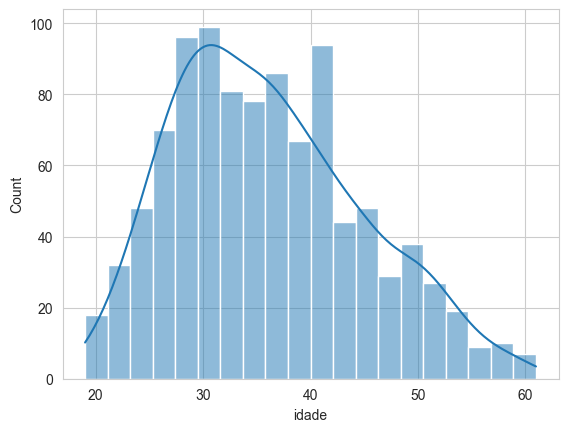

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("whitegrid")
sns.histplot(anuncios["idade"], bins=20, kde=True)

plt.show()

- Qual a renda dos usuários do site e qual a relação de idade?
    - A renda está mais concentrada dentre 20 - 40 anos, e numa faixa acima de 5000K

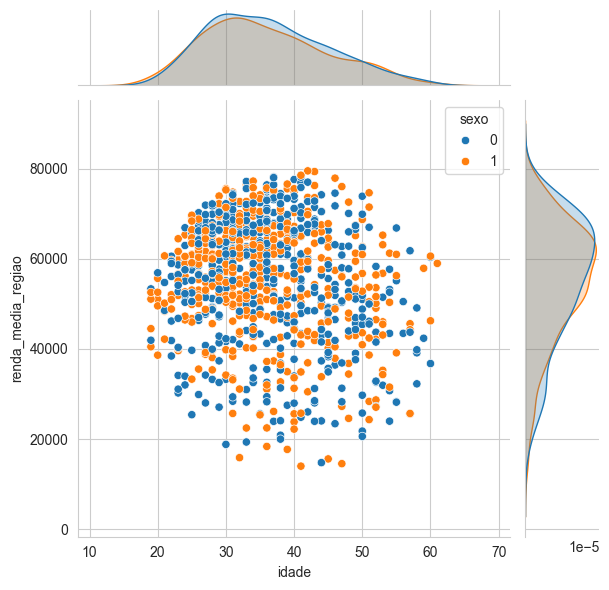

In [29]:
sns.jointplot(x=anuncios['idade'],y=anuncios['renda_media_regiao'],hue=anuncios['sexo'])

plt.show()

- Pessoas mais novas gastam mais tempo no site do que os mais velhos?
    - Sim, as pessoas entre 20 e 40 anos gastam em média 70/80 minutos diários no site

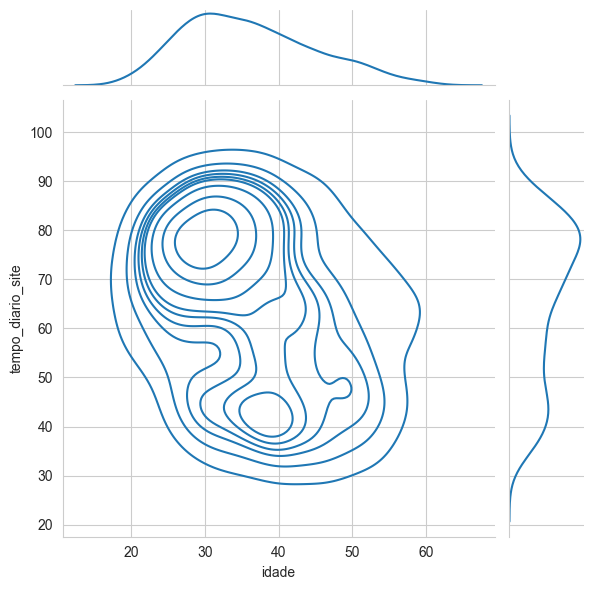

In [30]:
sns.jointplot(x=anuncios["idade"], y=anuncios["tempo_diario_site"], kind="kde")

plt.show()

- Qual a relação entre tempo na internet x site x renda ?
    - Pessoas que ficam mais tempo na internet também ficam mais tempo no nosso site e moram em uma região de alta renda média.


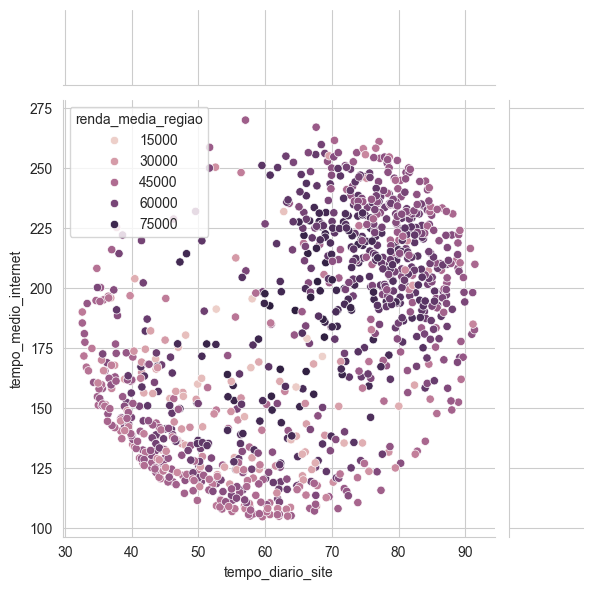

In [31]:
sns.jointplot(x=anuncios["tempo_diario_site"], y=anuncios["tempo_medio_internet"],hue=anuncios['renda_media_regiao'])

plt.show()

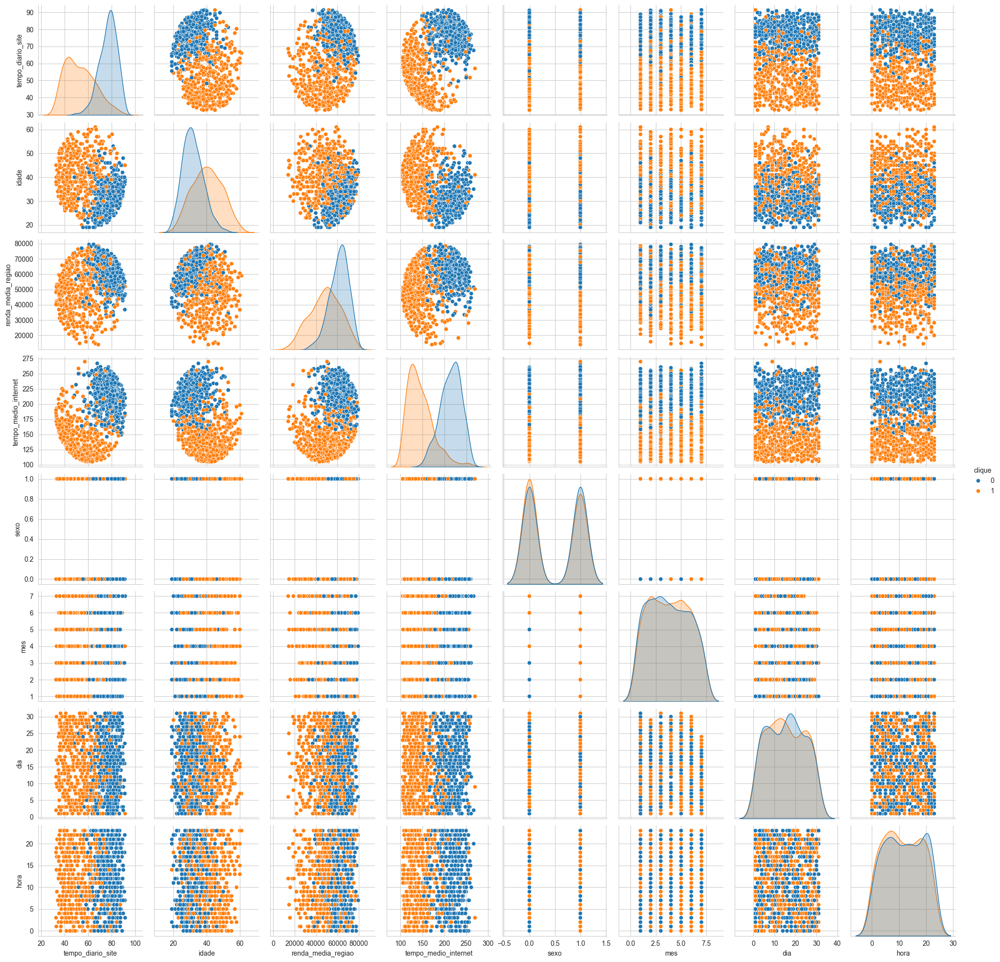

In [32]:
sns.pairplot(anuncios,hue="clique")
plt.show()


In [58]:
from sklearn.model_selection import train_test_split
x = anuncios[["tempo_diario_site", "idade", "renda_media_regiao", "tempo_medio_internet"]]
y = anuncios["clique"]

In [59]:
x_train,x_test,y_train,y_test = train_test_split(x,y, test_size=0.3,random_state=42)

In [60]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score

In [61]:
lg = LogisticRegression()
lg.fit(x_train,y_train)

C:\Users\torre\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [62]:
ÿ_test = lg.predict(x_test)

In [63]:
accuracy_score(y_test,ÿ_test)

0.9366666666666666

In [65]:
print(classification_report(y_test,ÿ_test))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94       146
           1       0.96      0.92      0.94       154

    accuracy                           0.94       300
   macro avg       0.94      0.94      0.94       300
weighted avg       0.94      0.94      0.94       300

